# House Price Prediction

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company uses data analytics to purchase houses at a price below their actual values and flip them on at a higher price. For the same purpose, the company has collected a data set from the sale of houses in Australia.

The data is provided in the CSV file below.

The company is looking at prospective properties to buy to enter the market. You are required to build a regression model using regularisation in order to predict the actual value of the prospective properties and decide whether to invest in them or not.

## Objective

The company wants to know:
-   Which variables are significant in predicting the price of a house, and
-   How well those variables describe the price of a house.

## Business Goal

You are required to model the price of houses with the available independent variables. This model will then be used by the management to understand how exactly the prices vary with the variables. They can accordingly manipulate the strategy of the firm and concentrate on areas that will yield high returns. Further, the model will be a good way for management to understand the pricing dynamics of a new market.



https://www.kaggle.com/life2short/eda-and-outliers

https://www.kaggle.com/dgawlik/house-prices-eda

https://www.kaggle.com/dejavu23/house-prices-eda-to-ml-beginner

https://www.kaggle.com/pmarcelino/comprehensive-data-exploration-with-python

https://www.kaggle.com/apapiu/regularized-linear-models

https://www.kaggle.com/masumrumi/a-detailed-regression-guide-with-house-pricing



In [1]:
#Load Libraries

import pandas as pd 
import numpy as np 
import matplotlib.pyplot as plt 
import seaborn as sns 

from sklearn.model_selection import train_test_split,KFold,GridSearchCV
from sklearn.feature_selection import RFECV
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.metrics import r2_score


import os
import warnings
warnings.filterwarnings('ignore')

sns.set_style('darkgrid')
pd.set_option('display.max_columns', 500)

## Load Dataset and Data Definition

In [2]:
# Load dataframe
housing_df = pd.read_csv('./train.csv')
housing_df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [3]:
# Load Data Definition
with open('./data_description.txt') as f:
    print(f.read())

MSSubClass: Identifies the type of dwelling involved in the sale.	

        20	1-STORY 1946 & NEWER ALL STYLES
        30	1-STORY 1945 & OLDER
        40	1-STORY W/FINISHED ATTIC ALL AGES
        45	1-1/2 STORY - UNFINISHED ALL AGES
        50	1-1/2 STORY FINISHED ALL AGES
        60	2-STORY 1946 & NEWER
        70	2-STORY 1945 & OLDER
        75	2-1/2 STORY ALL AGES
        80	SPLIT OR MULTI-LEVEL
        85	SPLIT FOYER
        90	DUPLEX - ALL STYLES AND AGES
       120	1-STORY PUD (Planned Unit Development) - 1946 & NEWER
       150	1-1/2 STORY PUD - ALL AGES
       160	2-STORY PUD - 1946 & NEWER
       180	PUD - MULTILEVEL - INCL SPLIT LEV/FOYER
       190	2 FAMILY CONVERSION - ALL STYLES AND AGES

MSZoning: Identifies the general zoning classification of the sale.
		
       A	Agriculture
       C	Commercial
       FV	Floating Village Residential
       I	Industrial
       RH	Residential High Density
       RL	Residential Low Density
       RP	Residential Low Density Park 
       RM

__ The Target or Independent Variable that we have to predict is the `SalePrice` column. __

## Exploratory Data Analysis

1.  We will check the data type for every feature and verify that it matches the data definition.
2.  Let us check and analyze different statistical properties for the given dataset.
3.  We will look into the categorical and continous features separately.


In [4]:
housing_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

_Perhaps the `Id` column is redundant and can be dropped._

In [5]:
housing_df.drop(columns='Id',inplace=True)

_Although the columns `MSSubClass`, `OverallQual`, `OverallCond` are supposed to contain categorical information, yet the data type is `Int64`._

We have to treat these features.

__Describe Statistics__

In [6]:
housing_df.describe()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


_As we can observe, the maximun SalePrice is `755000` and the minimum is `34900`._ </br>
_The Median price is `163000` and the Mean price is `180921`._

__Missing Values__

__TODO__ : Fill missing values in columns having NA as values as None and for the rest fill with median or mean

Lets check the missing values in the features and decide on how to handle them.

In [7]:
def find_missing_values(df):
    total = df.isnull().sum().sort_values(ascending=False)
    percent = (df.isnull().sum()/df.isnull().count()).sort_values(ascending=False)
    missing_data = pd.concat([total,percent],axis=1,keys=['Total','Percent'])
    plt.title('Missing Values')
  
    return missing_data

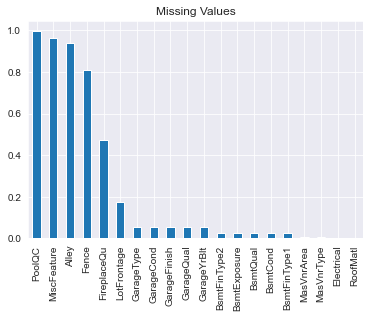

,Total,Percent
PoolQC,1453,0.995205
MiscFeature,1406,0.963014
Alley,1369,0.937671
Fence,1179,0.807534
FireplaceQu,690,0.472603
LotFrontage,259,0.177397
GarageType,81,0.055479
GarageCond,81,0.055479
GarageFinish,81,0.055479
GarageQual,81,0.055479


In [8]:
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

On looking at the dictionary we can find that many of the categorical columns have `NA` as one of the categories which is being mistaken by pandas as a missing values.

We will handle this first before handling the missing values.

In [9]:
# columns with NA as a category 
cols_with_na_category = ['MiscFeature','Alley','Fence','FireplaceQu',
               'GarageQual','GarageCond','GarageFinish','GarageType',
               'BsmtExposure','BsmtCond','BsmtQual','BsmtFinType1','BsmtFinType2','PoolQC']

# replace 'Na' with 'None' in these columns
for col in cols_with_na_category:
    housing_df[col].fillna('None',inplace=True)

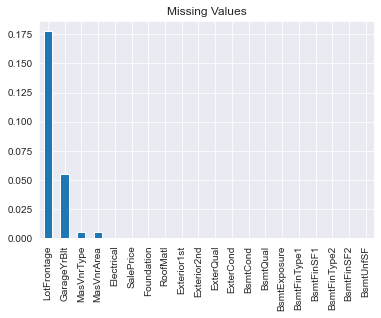

,Total,Percent
LotFrontage,259,0.177397
GarageYrBlt,81,0.055479
MasVnrType,8,0.005479
MasVnrArea,8,0.005479
Electrical,1,0.000685
SalePrice,0,0.000000
Foundation,0,0.000000
RoofMatl,0,0.000000
Exterior1st,0,0.000000
Exterior2nd,0,0.000000


In [10]:
# Lets Check missing values again
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

_Before deciding on the method of imputing missing values, lets check for outliers in the columns._

In [11]:
housing_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,None,None,None,0,2,2008,WD,Normal,208500
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,None,None,None,0,5,2007,WD,Normal,181500
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,None,None,None,0,9,2008,WD,Normal,223500
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,None,None,None,0,2,2006,WD,Abnorml,140000
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,None,None,None,0,12,2008,WD,Normal,250000


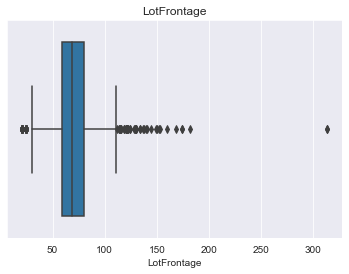

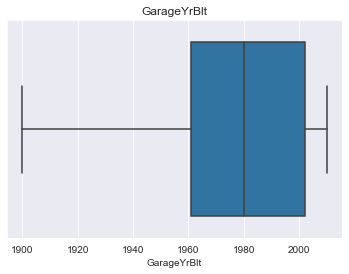

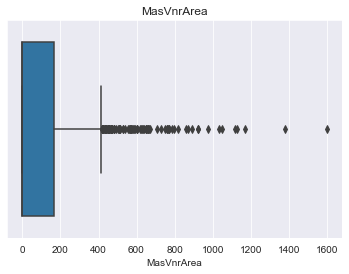

In [12]:
num_feat_missing = ['LotFrontage','GarageYrBlt','MasVnrArea']# Numerical features
for col in num_feat_missing:
    plt.title(col)
    sns.boxplot(x = housing_df[col])
    plt.show()

_There seems to be a lot of outliers, we will use median to impute the missing values._

In [13]:
housing_df[num_feat_missing] = housing_df[num_feat_missing].fillna(housing_df[num_feat_missing].median())

In [14]:
housing_df['MasVnrType'].value_counts()

None       864
BrkFace    445
Stone      128
BrkCmn      15
Name: MasVnrType, dtype: int64

In [15]:
housing_df['Electrical'].value_counts()

SBrkr    1334
FuseA      94
FuseF      27
FuseP       3
Mix         1
Name: Electrical, dtype: int64

In [16]:
# For categorical variables we will use mode imputation
housing_df['MasVnrType'] = housing_df['MasVnrType'].fillna('BrkFace')
housing_df['Electrical'] = housing_df['Electrical'].fillna('SBrkr')

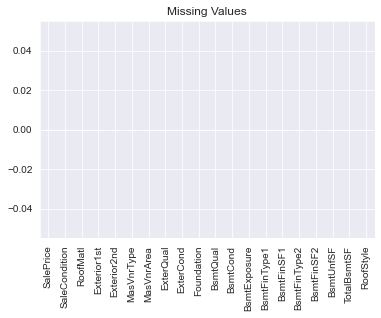

,Total,Percent
SalePrice,0,0.0
SaleCondition,0,0.0
RoofMatl,0,0.0
Exterior1st,0,0.0
Exterior2nd,0,0.0
MasVnrType,0,0.0
MasVnrArea,0,0.0
ExterQual,0,0.0
ExterCond,0,0.0
Foundation,0,0.0


In [17]:
# Lets Check missing values again
missing_data = find_missing_values(housing_df)
missing_data['Percent'].head(20).plot.bar()
plt.show()
missing_data.head(20)

#### Distribution of Target Variable

In [18]:
# def show_distribution(data):

#     plt.figure(figsize=(10,7))
#     sns.distplot(a=data)
#     plt.show()

# show_distribution(housing_df.SalePrice)

_The Sale price column has some positive skew and is not normally distributed._ <br>
_We will take a log transformation of the same to bring it closer to a normal distribution_.

In [19]:
# housing_df['SalePrice'] = np.log(housing_df['SalePrice'])
# show_distribution(housing_df['SalePrice'])

#### Separate Numerical and Categorical Features

We will observe the behavior of various numerical and Categorical features with the target variable the `SalePrice`.

In [20]:
num_features_df = housing_df.select_dtypes(exclude=['object'])
categorical_features_df = housing_df.select_dtypes(include=['object'])

In [21]:
num_features_df.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


_Some of the features are categorical in nature although being numerical. We have separate them from analysis_.

#### Relation of Temporal Features with the Target

In [22]:
# Extract Year Features
year_features = [feature for feature in num_features_df.columns if 'Yr' in feature or 'Year' in feature]

print(f'Year Features are: {year_features}')

Year Features are: ['YearBuilt', 'YearRemodAdd', 'GarageYrBlt', 'YrSold']


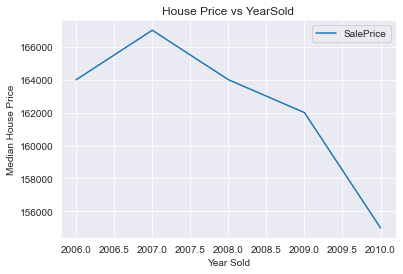

In [23]:
# Year Sold Vs SalePrice
housing_df.groupby('YrSold').agg({'SalePrice':'median'}).plot()
plt.xlabel('Year Sold')
plt.ylabel('Median House Price')
plt.title("House Price vs YearSold")
plt.show()

The Median sale price seems to be decreasing which should not be the case. <br>
We will examine this behavior further by taking the difference between the year features and when it was sold.

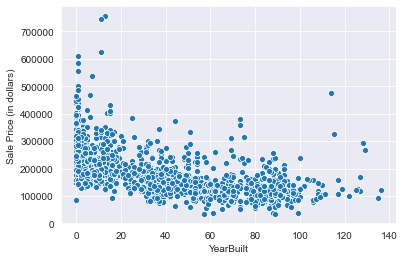

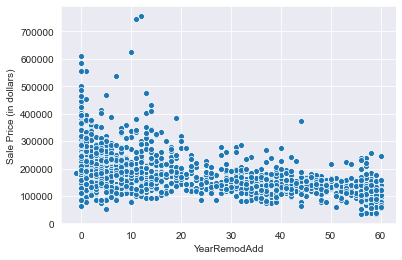

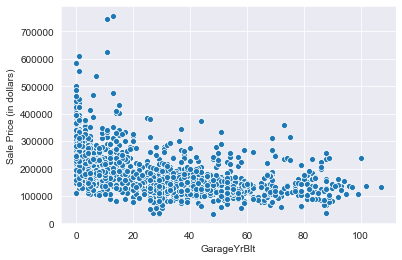

In [24]:
for feature in year_features:
    if feature != 'YrSold':
        year_diff_df = housing_df.copy()
        year_diff_df[feature]=year_diff_df['YrSold']-year_diff_df[feature]
        sns.scatterplot(x =feature, y= 'SalePrice', data =year_diff_df )
        plt.ylabel('Sale Price (in dollars)')
        plt.xlabel(f"{feature}")
        plt.show()

We can easily say from the above observations that if the house is relatively new or even if the modifications done to it are recent,<br>
it will attract higher Sale price.

#### Discrete features

We will examine this features which are continous but can only take a handful of values.


In [25]:
discrete_features = [feature for feature in num_features_df.columns \
                    if len(num_features_df[feature].unique())<25 \
                        and feature not in year_features]

print(f'The discrete features are: {discrete_features}')

The discrete features are: ['MSSubClass', 'OverallQual', 'OverallCond', 'LowQualFinSF', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces', 'GarageCars', '3SsnPorch', 'PoolArea', 'MiscVal', 'MoSold']


#### Discrete Features vs SalePrice

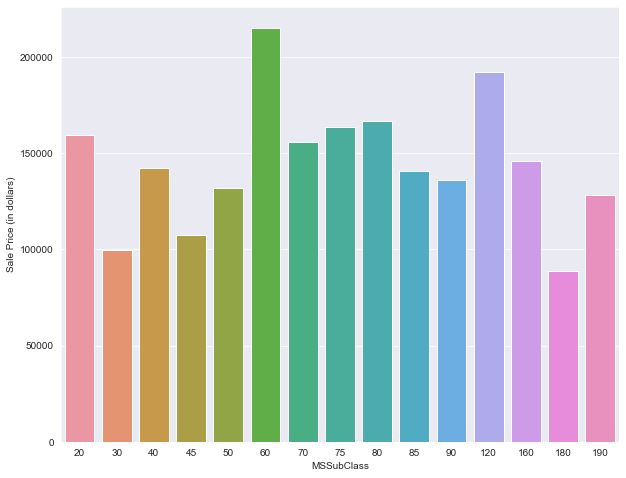

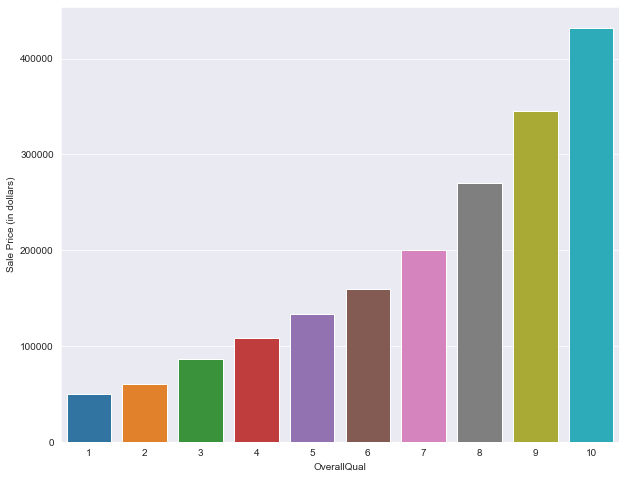

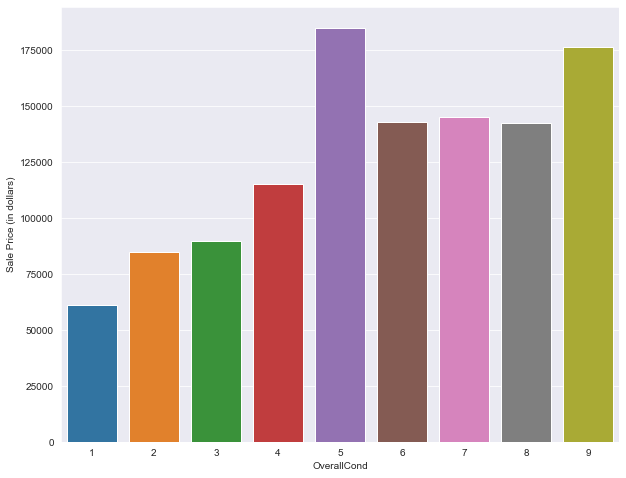

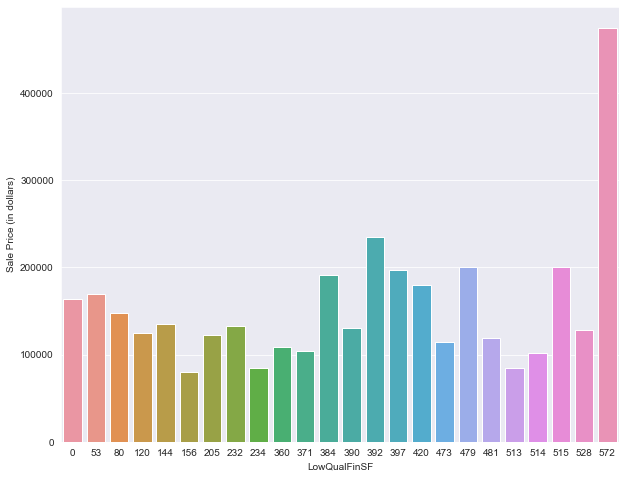

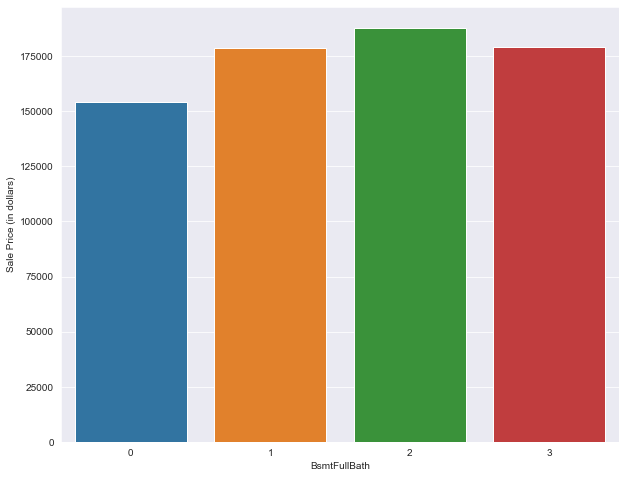

...

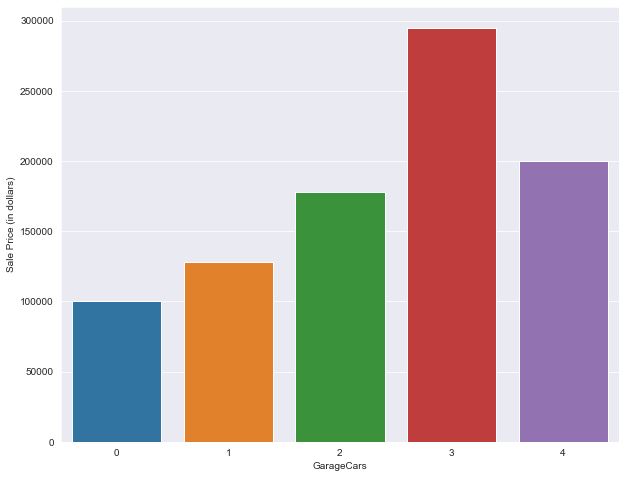

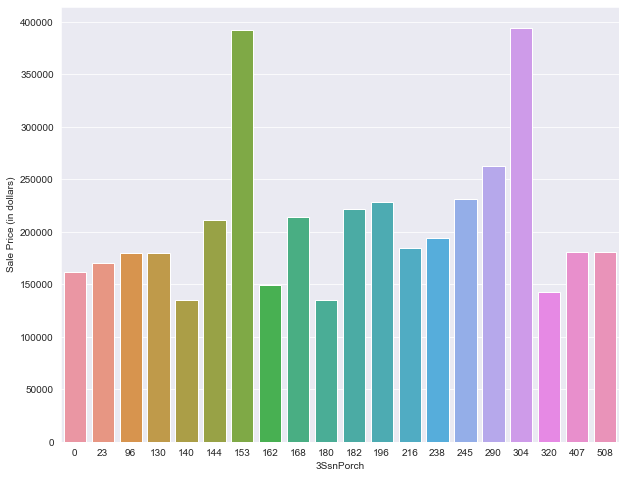

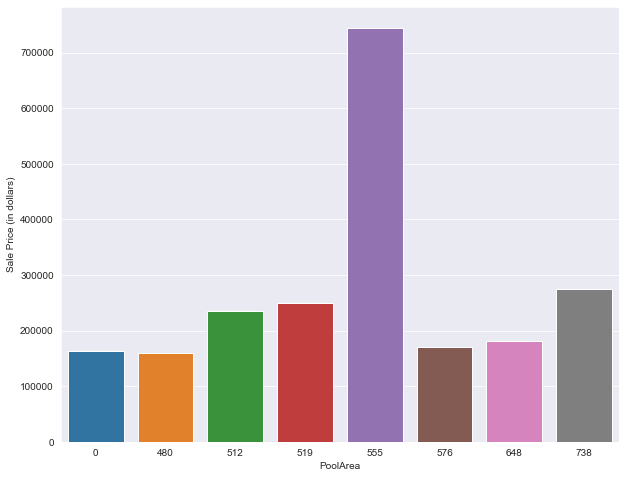

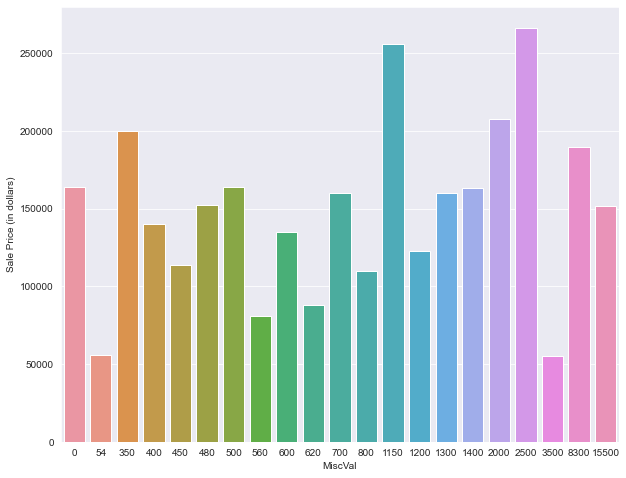

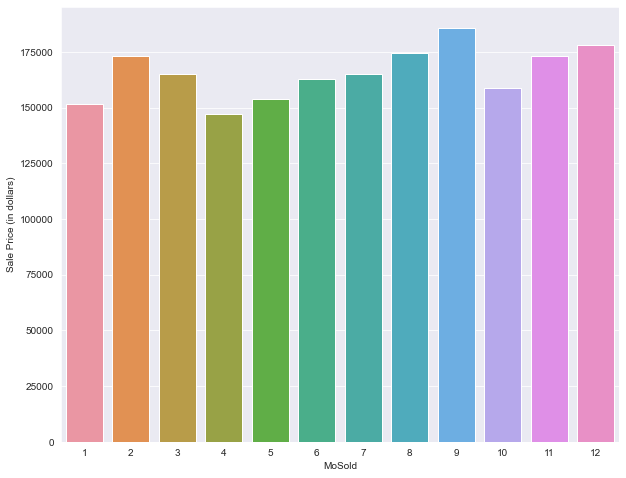

In [26]:
for feature in discrete_features:
    
    discrete_df = housing_df.groupby(feature).agg({'SalePrice':'median'})
    plt.figure(figsize=(10,8))
    sns.barplot(x = discrete_df.index, y= 'SalePrice', data =discrete_df )
    plt.ylabel('Sale Price (in dollars)')
    plt.xlabel(f"{feature}")
    plt.show()

-   For some of the mssubclass the sale price is high.
-   Overall qual/cond increases price increases.
-   More full bathrooms attract higher price


Now lets check for percentage of each category in discrete features.
We will check for skewed categories and if found we will drop it.



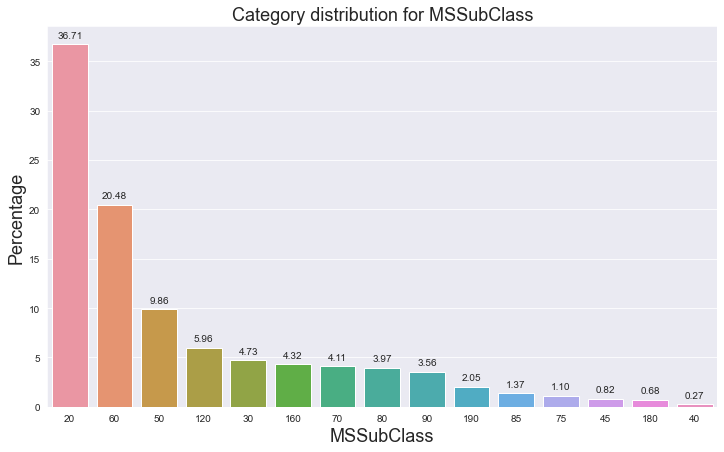

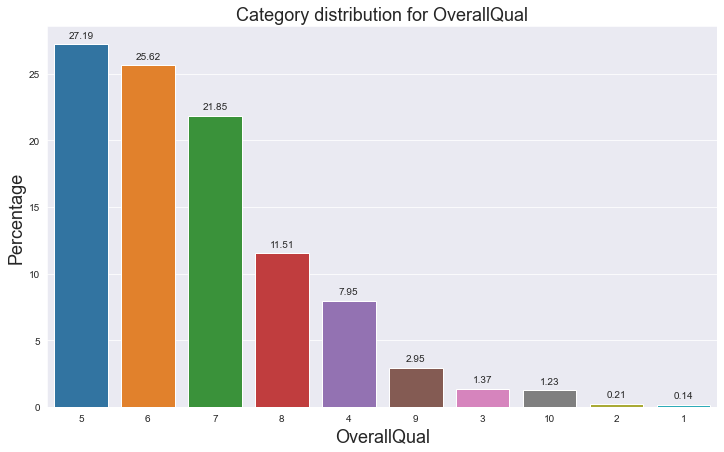

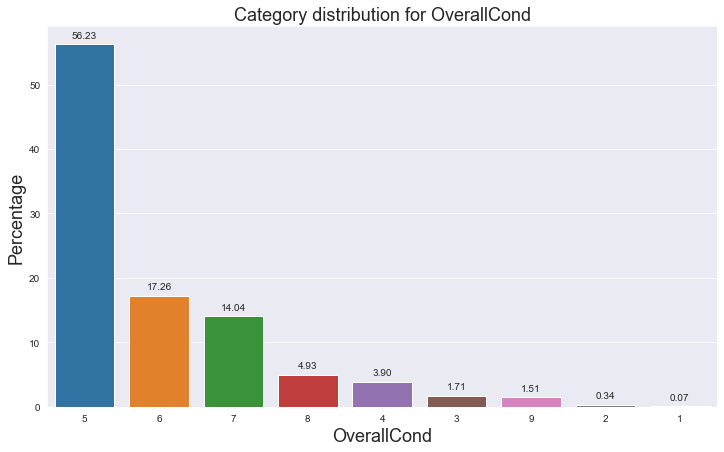

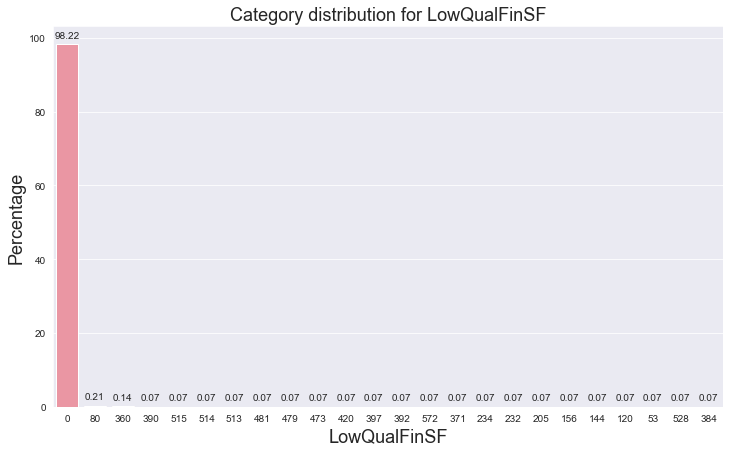

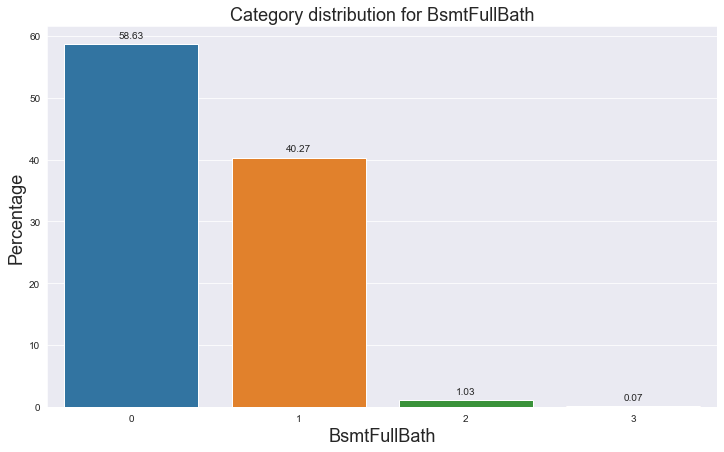

...

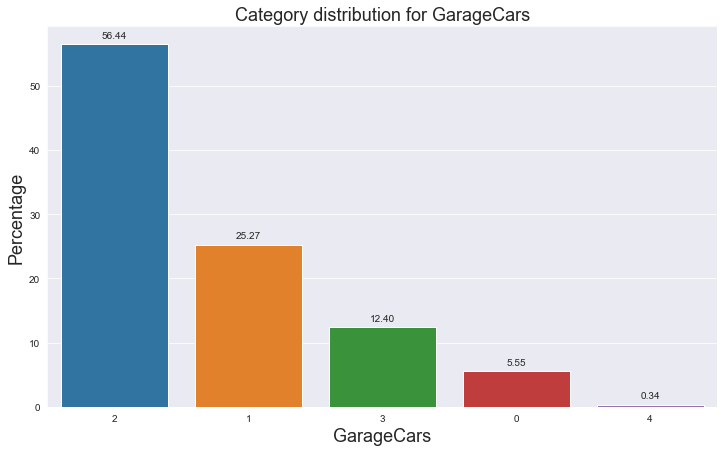

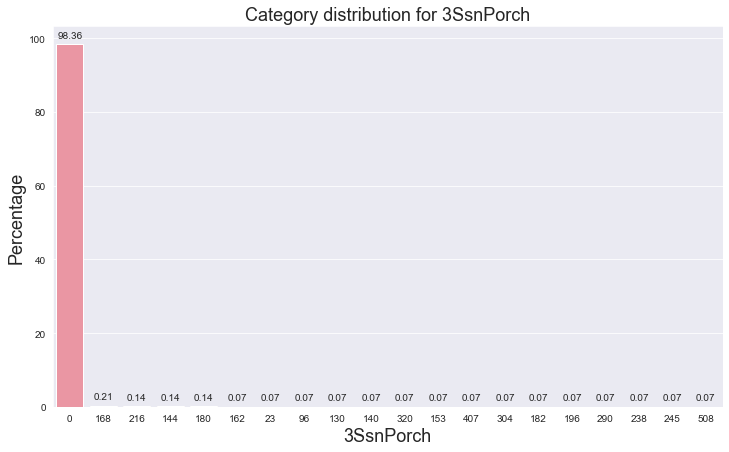

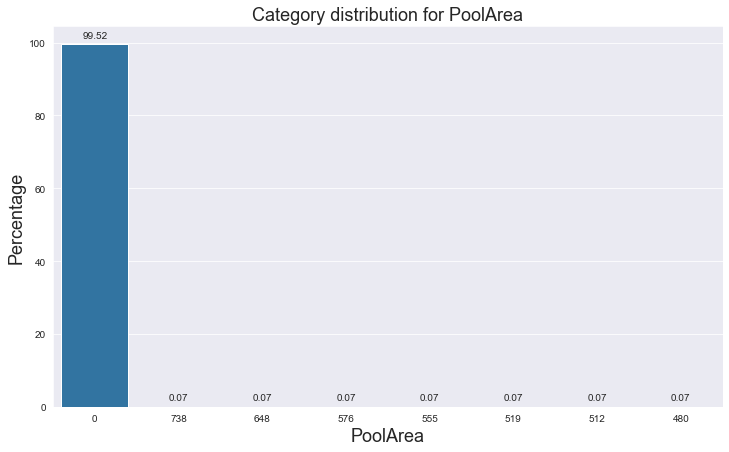

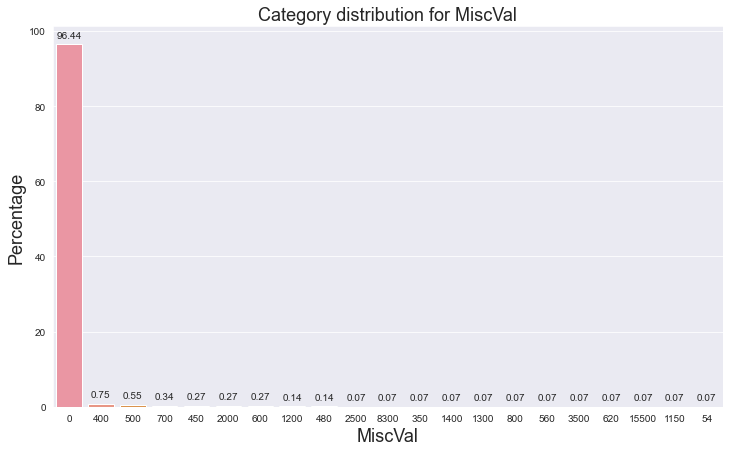

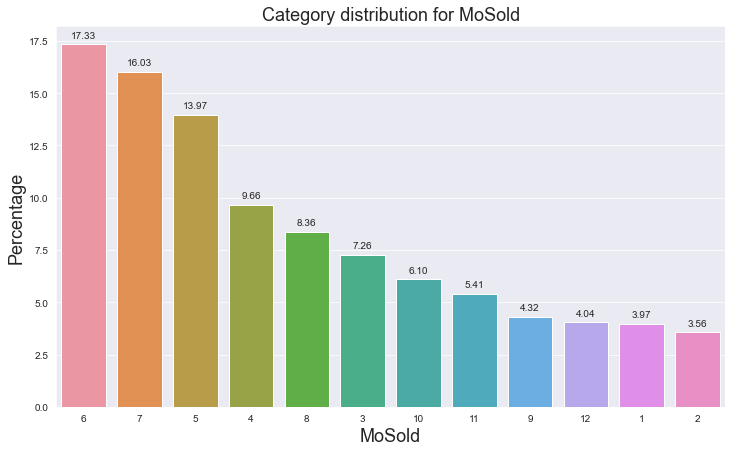

In [28]:
def plot_categories_for_feature(feature):
    
    temp = housing_df[feature].value_counts(normalize=True)*100
    temp_df = pd.DataFrame({'percentages':temp})
    temp_df.sort_values(by = 'percentages', inplace=True,ascending=False)

    # print(temp_df)

    plt.figure(figsize=(12,7))
    plt.title(f'Category distribution for {feature}',fontsize=18)
    splot =sns.barplot(x = temp_df.index , y = temp_df.percentages,order = temp_df.index)
    for p in splot.patches:
        splot.annotate(format(p.get_height(), '.2f'), 
                    (p.get_x() + p.get_width() / 2., p.get_height()), 
                    ha = 'center', va = 'center', 
                    xytext = (0, 9), 
                    textcoords = 'offset points')
    plt.xlabel(feature,fontsize=18)
    plt.ylabel('Percentage',fontsize=18)                
    plt.show()
    
for feature in discrete_features:
    plot_categories_for_feature(feature,)

_As is visible from the above plots some of the Discrete features like LowQualFinSF, MiscVal, PoolArea, 3SsnPorch, BsmtHalfBath, KitchenAbvGr_ <br>
_have highly skewed category distribution. We should drop them as the dominant category can influence our model coefficients_

In [29]:
housing_df.drop(columns=['LowQualFinSF', 'MiscVal', 'PoolArea', '3SsnPorch', 'BsmtHalfBath', 'KitchenAbvGr'],inplace=True)

#### Continous Features 

Let's check the correlations among the continous numerical features.

In [30]:
continous_features = [feature for feature in num_features_df.columns \
                        if feature not in year_features+discrete_features ]

print(f'The Continous features are: {continous_features}')

The Continous features are: ['LotFrontage', 'LotArea', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', 'ScreenPorch', 'SalePrice']


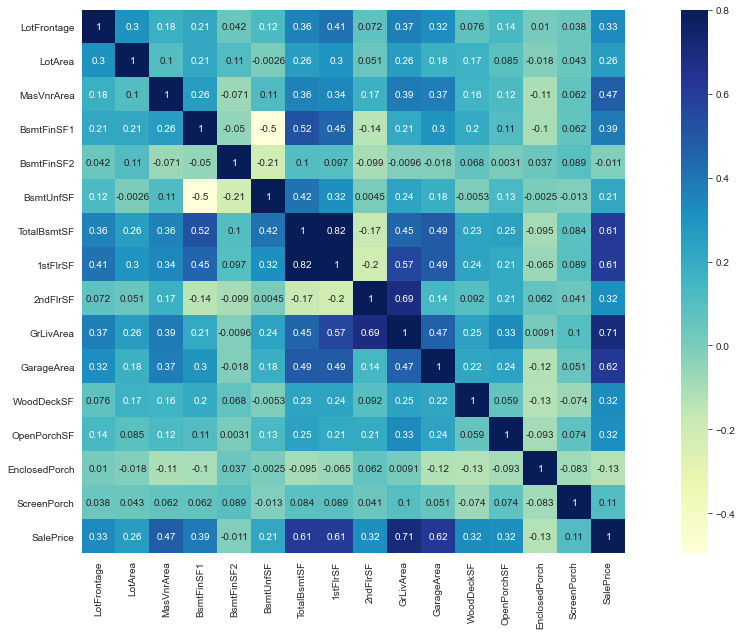

In [31]:
plt.figure(figsize=(20,10))
correlations = num_features_df[continous_features].corr()
sns.heatmap(correlations,annot=True,vmax=.8,cmap='YlGnBu',square=True)
plt.show()

We can clearly see some of the features are having high correlation with the SalePrice. <br>
Some of the features are GarageArea, 2ndFlrSF, TotalBsmtSF etc.
Lets check them in a more detailed manner. 

We can also see that some of the independent variables are correlated with each other.<br>
This multicollinearity can cause issues while model building and we have to drop some of them.

Lets check the top 10 correlated variables.

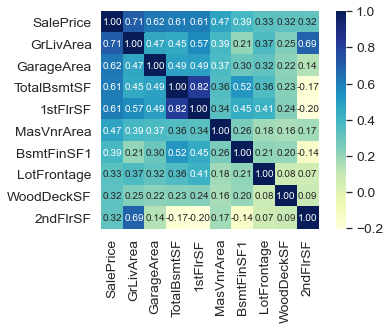

In [32]:
cols = correlations.nlargest(10, 'SalePrice')['SalePrice'].index
correlations_top_10 = np.corrcoef(housing_df[cols].values.T)
sns.set(font_scale=1.25)
hm = sns.heatmap(correlations_top_10, cbar=True,cmap='YlGnBu', annot=True, square=True, fmt='.2f', annot_kws={'size': 10}, yticklabels=cols.values, xticklabels=cols.values)
plt.show()

<Figure size 72x720 with 0 Axes>

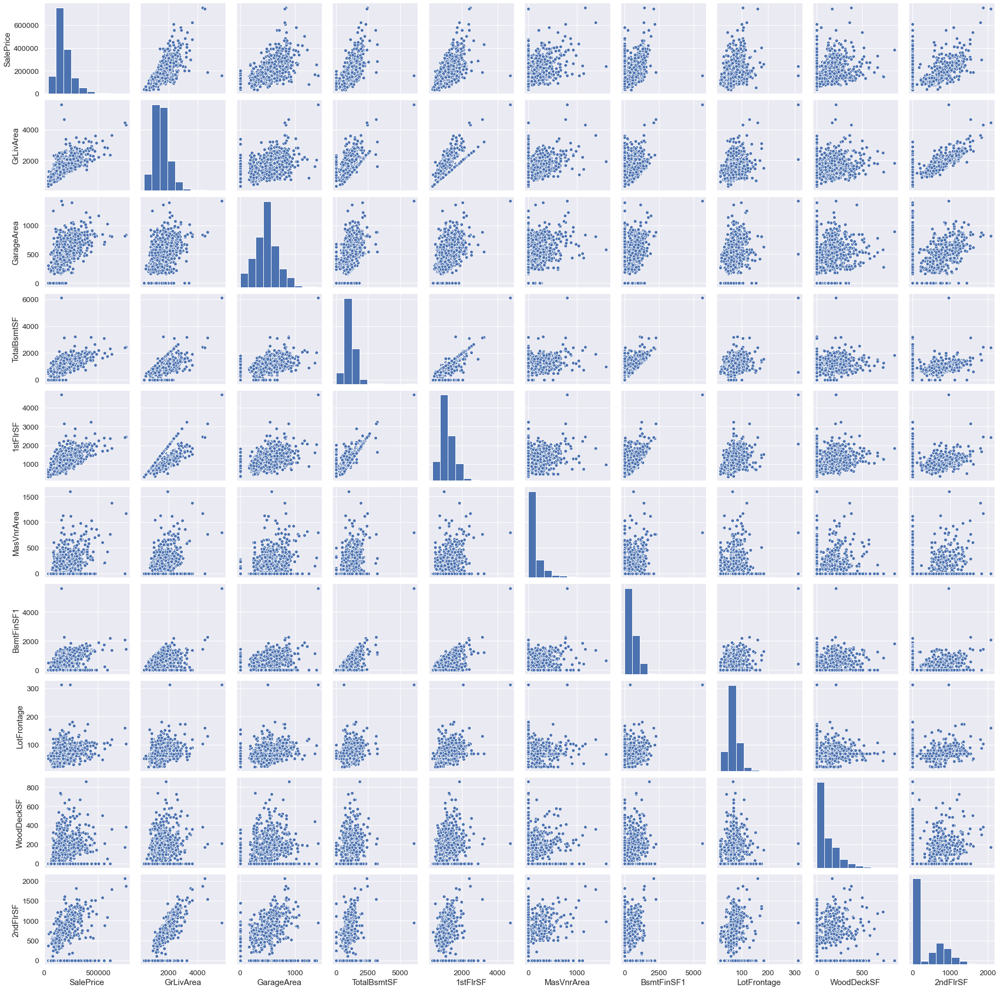

In [33]:

plt.figure(figsize=(1,10))
sns.pairplot(housing_df[cols])
plt.show()

If we look at scatter plots w.r.t SalePrice, most of the features are somewhat having linear relationship with SalePrice. <br>
Also the histograms of some of the features appear to be skewed. So will have to treat them before modelling.

TODO:  Log transformation and plot histograms

#### Categorical Features vs SalePrice

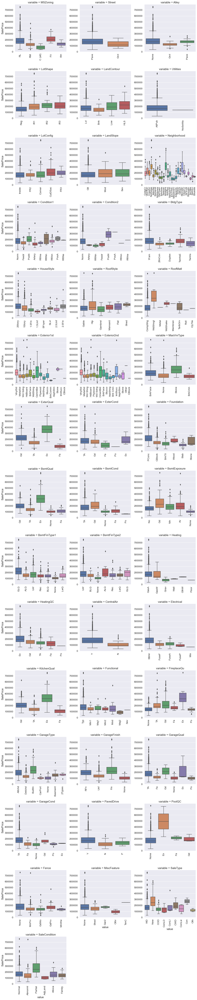

In [34]:
def boxplot(x, y, **kwargs):
    sns.boxplot(x=x, y=y)
    x=plt.xticks(rotation=90)
f = pd.melt(housing_df, id_vars=['SalePrice'], value_vars=categorical_features_df.columns)
g = sns.FacetGrid(f, col="variable",  col_wrap=3, sharex=False, sharey=False, size=5)
g = g.map(boxplot, "value", "SalePrice")

In [35]:
# lets check the number of categories per categrorical feature
for feature in categorical_features_df.columns:
    print(f'Number of Categories for feature {feature} are {len(categorical_features_df[feature].unique())}')

Number of Categories for feature MSZoning are 5
Number of Categories for feature Street are 2
Number of Categories for feature Alley are 3
Number of Categories for feature LotShape are 4
Number of Categories for feature LandContour are 4
Number of Categories for feature Utilities are 2
Number of Categories for feature LotConfig are 5
Number of Categories for feature LandSlope are 3
Number of Categories for feature Neighborhood are 25
Number of Categories for feature Condition1 are 9
Number of Categories for feature Condition2 are 8
Number of Categories for feature BldgType are 5
Number of Categories for feature HouseStyle are 8
Number of Categories for feature RoofStyle are 6
Number of Categories for feature RoofMatl are 8
Number of Categories for feature Exterior1st are 15
Number of Categories for feature Exterior2nd are 16
Number of Categories for feature MasVnrType are 4
Number of Categories for feature ExterQual are 4
Number of Categories for feature ExterCond are 5
Number of Categ

There are a few features with more than 15 categories, we need a proper way to handle these.

We will check for categorical features with Rare Categories or with any Skewed Categories.

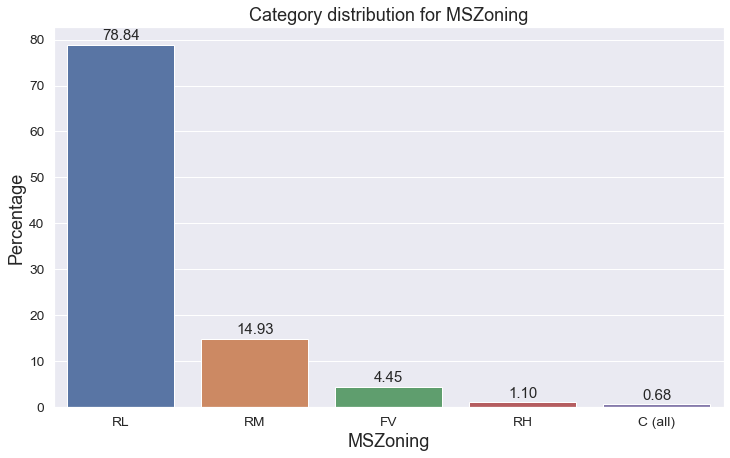

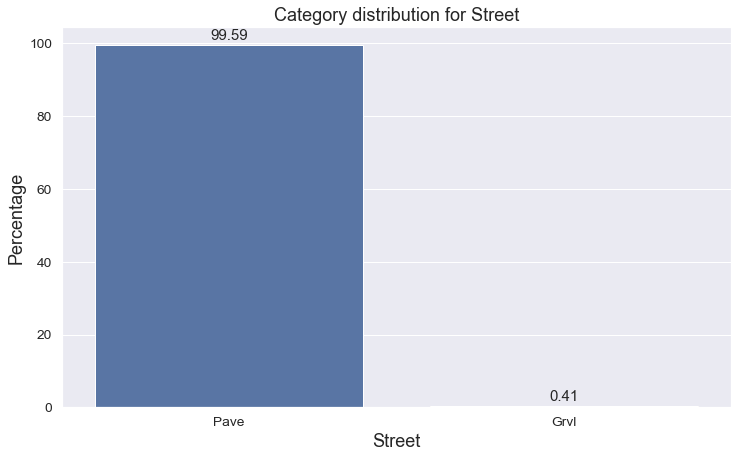

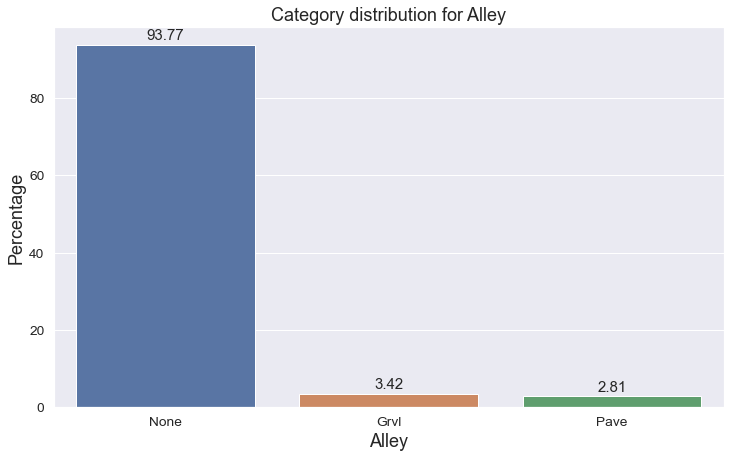

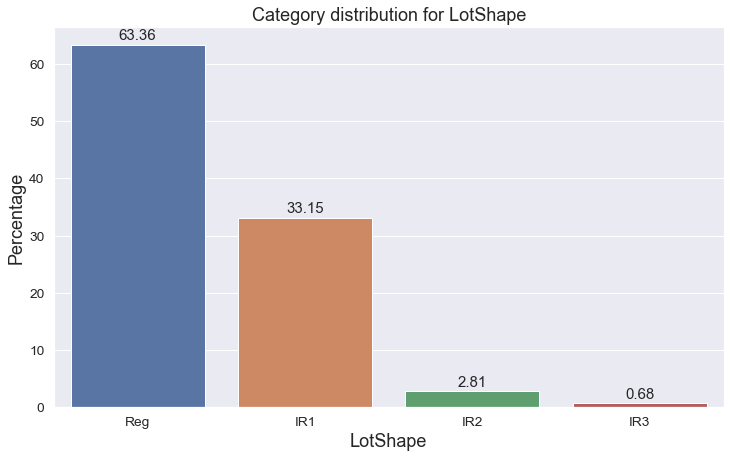

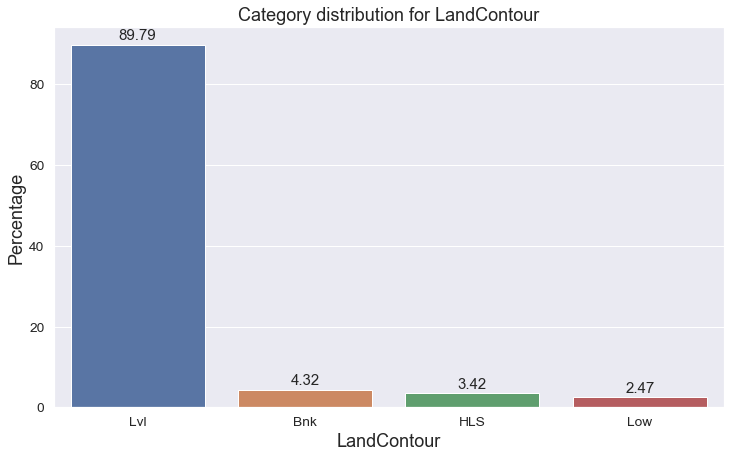

...

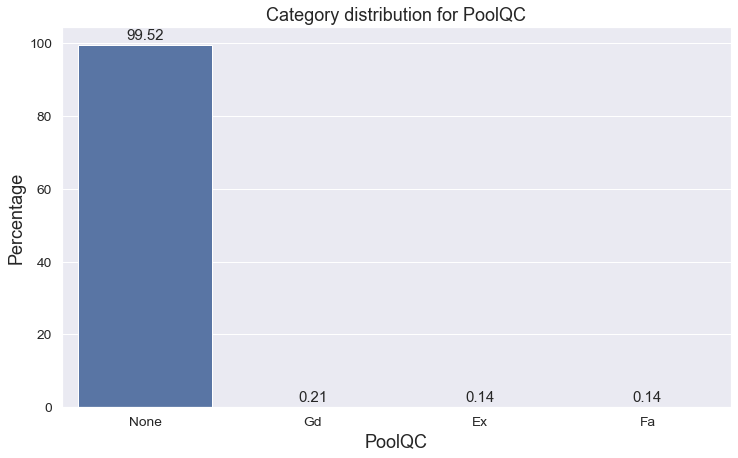

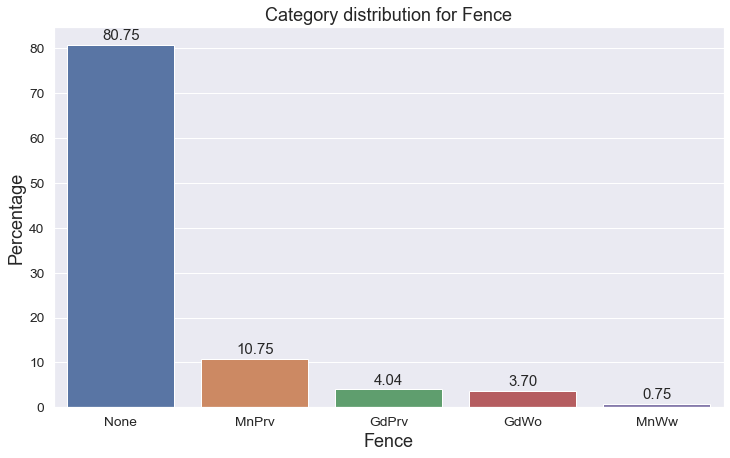

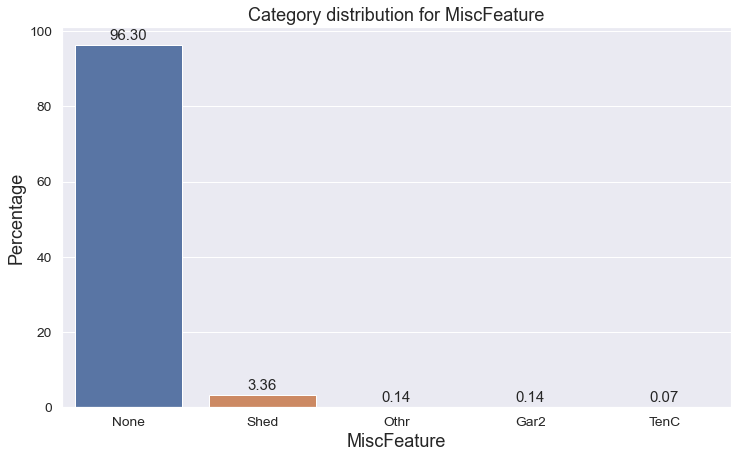

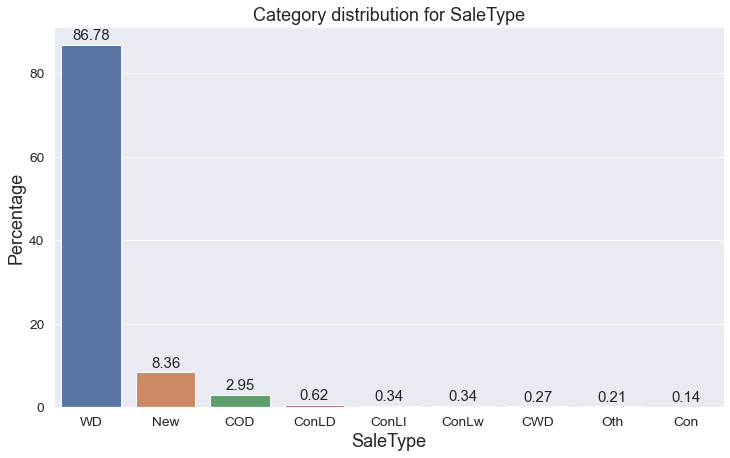

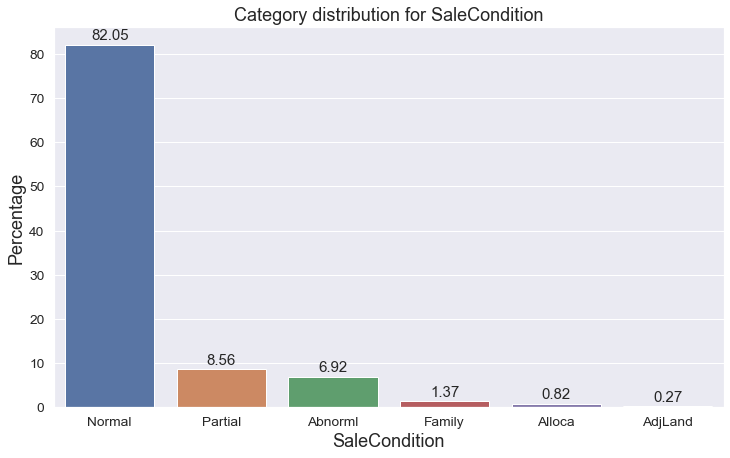

In [36]:
for feature in categorical_features_df.columns:
    plot_categories_for_feature(feature)

As we have already handled the skewed discrete features we will also handle the Categorical features in a similar fashion.<br>
We will drop the following columns because of skewed categories: <br>

1. MiscFeature
2. PoolQC
3. Heating
4. Condition2
5. RoofMatl
6. Street
7. Utilities

In [39]:
housing_df.drop(columns=['MiscFeature','PoolQC','Heating','Condition2','RoofMatl','Street','Utilities'],inplace=True)

Now we will club the categories with less 1% observations into a new category called Rare

### Outliers

Now presence of Outliers can influence our model coefficients which impact our model predictions.
Lets see if our continous features have any outliers.

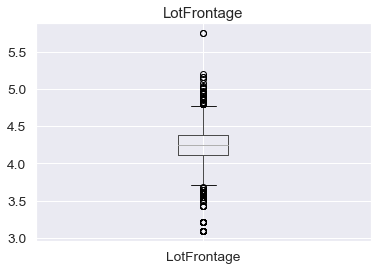

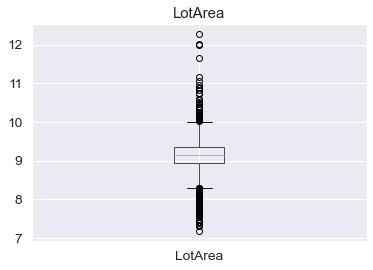

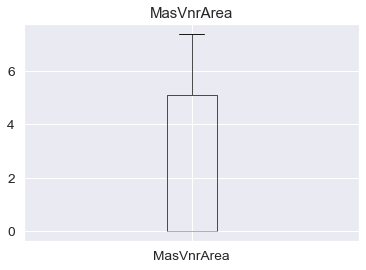

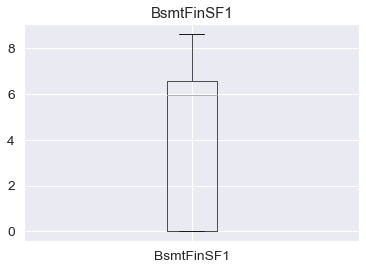

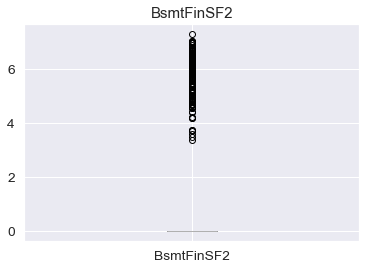

...

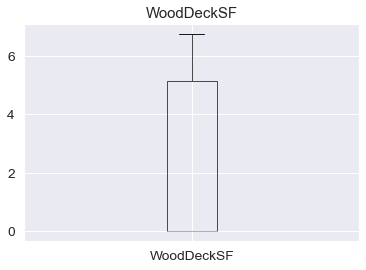

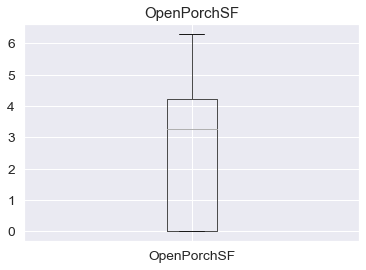

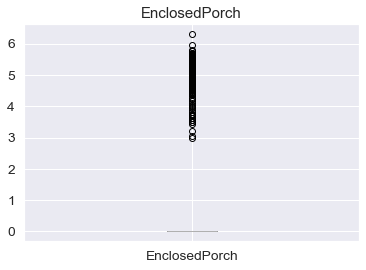

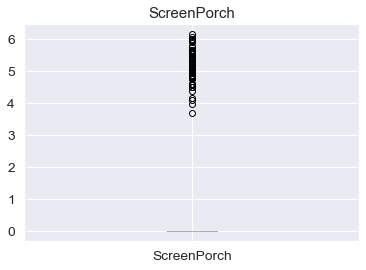

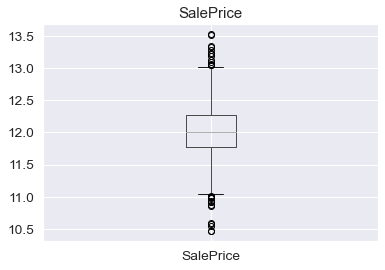

In [33]:
log_features_df = num_features_df.copy()

for feature in continous_features:
    log_features_df[feature] = np.log(log_features_df[feature]+1)
    log_features_df.boxplot(column=feature)
    
    plt.title(feature)
    plt.show()

We can clearly see that there outliers present in the above features. We will have to handle them during the feature engineering.

## Feature Engineering

We will build some interesting features from the existing featureset which will help in model building.

#### Remove Outliers

In [34]:

# outliers_removed_df = housing_df.copy()
# outliers_removed_df.drop('SalePrice',axis=1,inplace=True)
# outlier_features = continous_features.copy()
# outlier_features.remove('SalePrice')

# # Get Interquartile range for all continous features
# Q1 = outliers_removed_df[outlier_features].quantile(0.25)
# Q3 = outliers_removed_df[outlier_features].quantile(0.75)
# IQR = Q3 - Q1
# print(IQR)

In [35]:
# # Remove all the rows observations which is not within 1.5 times of the IQR
# outliers_removed_df = outliers_removed_df[~((outliers_removed_df < (Q1 - 1.5 * IQR)) |(outliers_removed_df > (Q3 + 1.5 * IQR))).any(axis=1)]

In [36]:
# outliers_removed_df.info()

#### Remove Correlated Features

We will remove correlated features that provide the same information.
For this we will use the correlation matrix and remove the features which have a high correlation among them.

In [41]:
correlated_features = set()
correlation_matrix = housing_df[continous_features].drop('SalePrice', axis=1).corr()

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.7:
            colname = correlation_matrix.columns[i]
            correlated_features.add(colname)

In [42]:
print(f'The correlated features that need to be removed: {list(correlated_features)}')

The correlated features that need to be removed: ['GrLivArea', '1stFlrSF']


In [43]:
housing_df.drop(list(correlated_features),axis=1,inplace=True)

In [45]:
for feature in list(correlated_features):
    print(feature)
    continous_features.remove(feature)

GrLivArea
1stFlrSF


####  Adding year since feature for year columns


In [46]:

for feature in year_features:
    if feature != 'YrSold':
        housing_df[f'{feature}_minus_yrsold'] = housing_df['YrSold'] - housing_df[feature]

In [47]:
housing_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,YearBuilt_minus_yrsold,YearRemodAdd_minus_yrsold,GarageYrBlt_minus_yrsold
0,60,RL,65.0,8450,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,854,0,1,0,2,1,3,1,Gd,8,Typ,0,None,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,None,None,None,0,2,2008,WD,Normal,208500,5,5,5.0
1,20,RL,80.0,9600,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,0,0,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,None,None,None,0,5,2007,WD,Normal,181500,31,31,31.0
2,60,RL,68.0,11250,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,866,0,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,None,None,None,0,9,2008,WD,Normal,223500,7,6,7.0
3,70,RL,60.0,9550,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,None,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,756,0,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,None,None,None,0,2,2006,WD,Abnorml,140000,91,36,8.0
4,60,RL,84.0,14260,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1053,0,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,None,None,None,0,12,2008,WD,Normal,250000,8,8,8.0


In [48]:
# we will drop the original temporal features 
housing_df.drop(columns=year_features,inplace=True)

#### Log Transformation for Skewed Continous Features

In [49]:
converted_df = housing_df.copy()
for feature in continous_features:
    converted_df[feature] = np.log(housing_df[feature]+1)

In [50]:
converted_df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,YearBuilt_minus_yrsold,YearRemodAdd_minus_yrsold,GarageYrBlt_minus_yrsold
0,60,RL,4.189655,9.042040,Pave,None,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.283204,Gd,TA,PConc,Gd,TA,No,GLQ,6.561031,Unf,0.0,5.017280,6.753438,GasA,Ex,Y,SBrkr,6.751101,0,1,0,2,1,3,1,Gd,8,Typ,0,None,Attchd,RFn,2,6.308098,TA,TA,Y,0.000000,4.127134,0.000000,0,0.0,0,None,None,None,0,2,WD,Normal,12.247699,5,5,5.0
1,20,RL,4.394449,9.169623,Pave,None,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,Gable,CompShg,MetalSd,MetalSd,None,0.000000,TA,TA,CBlock,Gd,TA,Gd,ALQ,6.886532,Unf,0.0,5.652489,7.141245,GasA,Ex,Y,SBrkr,0.000000,0,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,RFn,2,6.133398,TA,TA,Y,5.700444,0.000000,0.000000,0,0.0,0,None,None,None,0,5,WD,Normal,12.109016,31,31,31.0
2,60,RL,4.234107,9.328212,Pave,None,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.093750,Gd,TA,PConc,Gd,TA,Mn,GLQ,6.188264,Unf,0.0,6.075346,6.825460,GasA,Ex,Y,SBrkr,6.765039,0,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,RFn,2,6.411818,TA,TA,Y,0.000000,3.761200,0.000000,0,0.0,0,None,None,None,0,9,WD,Normal,12.317171,7,6,7.0
3,70,RL,4.110874,9.164401,Pave,None,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,Gable,CompShg,Wd Sdng,Wd Shng,None,0.000000,TA,TA,BrkTil,TA,Gd,No,ALQ,5.379897,Unf,0.0,6.293419,6.629363,GasA,Gd,Y,SBrkr,6.629363,0,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,Unf,3,6.466145,TA,TA,Y,0.000000,3.583519,5.609472,0,0.0,0,None,None,None,0,2,WD,Abnorml,11.849405,91,36,8.0
4,60,RL,4.442651,9.565284,Pave,None,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,Gable,CompShg,VinylSd,VinylSd,BrkFace,5.860786,Gd,TA,PConc,Gd,TA,Av,GLQ,6.486161,Unf,0.0,6.196444,7.044033,GasA,Ex,Y,SBrkr,6.960348,0,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,RFn,3,6.729824,TA,TA,Y,5.262690,4.442651,0.000000,0,0.0,0,None,None,None,0,12,WD,Normal,12.429220,8,8,8.0


#### Handle Categorical Variables

As our model will only understand numerical values, we need to convert all the categories to numeric equivalents.<br>
We also saw some of the features have more as much as 25 categories we have to handle them differently.

In [64]:
# Create dummy variables and drop original columns
final_categorical_encoded = pd.get_dummies(converted_df,columns=categorical_features_df.columns,drop_first=True)

In [65]:
final_categorical_encoded.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SalePrice,YearBuilt_minus_yrsold,YearRemodAdd_minus_yrsold,GarageYrBlt_minus_yrsold,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,S

In [66]:
final_categorical_encoded.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Columns: 257 entries, MSSubClass to SaleCondition_Partial
dtypes: float64(15), int64(19), uint8(223)
memory usage: 705.9 KB


After handling categorical variables we have 259 features.

#### Split into train and test sets

In [67]:
num_features_df.head()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


In [68]:
features_to_be_scaled = [feature for feature in discrete_features+continous_features if feature not in year_features and feature != 'SalePrice']

In [69]:
y = final_categorical_encoded.pop('SalePrice')
X = final_categorical_encoded

X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.33, random_state=42)

#### Scaling

In [70]:
scaler = MinMaxScaler()
X_train[features_to_be_scaled] = scaler.fit_transform(X_train[features_to_be_scaled])
X_test[features_to_be_scaled]=scaler.transform(X_test[features_to_be_scaled])

In [73]:
X_train

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,2ndFlrSF,LowQualFinSF,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YearBuilt_minus_yrsold,YearRemodAdd_minus_yrsold,GarageYrBlt_minus_yrsold,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,Alley_None,Alley_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,MasVnrType_BrkFace,MasVnrType_None,MasVnrType_Stone,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_None,BsmtQual_TA,BsmtCond_Gd,BsmtCond_None,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtExposure_None,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_None,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_None,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,FireplaceQu_Fa,FireplaceQu_Gd,FireplaceQu_None,FireplaceQu_Po,FireplaceQu_TA,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageType_None,GarageFinish_None,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_None,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_None,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,PoolQC_Fa,PoolQC_Gd,PoolQC_None,Fence_GdWo,Fence_MnPrv,Fence_MnWw,Fence_None,MiscFeature_None,MiscFeature_Othr,MiscFeature_Shed,MiscFeature_TenC,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleConditi

## Modelling - 

In [141]:
# linear regression
lm = LinearRegression()
lasso_model = Lasso()
ridge_model = Ridge()

In [142]:
def fit_evalaute_one_model(model,X_train,X_test,y_train,y_test):
    
    scores = {}
    model.fit(X_train,y_train)

    y_train_preds = model.predict(X_train)
    training_r2 = r2_score(y_true=y_train, y_pred=y_train_preds)

    y_test_preds = model.predict(X_test)
    testing_r2 = r2_score(y_true=y_test, y_pred=y_test_preds)

    scores['model'] = str(model.__class__).split('.')[-1][:-2]
    scores['training_r2'] = training_r2
    scores['testing_r2'] = testing_r2
    

    return scores



In [143]:
def fit_evalaute_models(model_list,X_train,X_test,y_train,y_test):


    scores_df = pd.DataFrame()
    for model in model_list:
        scores = fit_evalaute_one_model(model,X_train,X_test,y_train,y_test)
        print(scores)
        scores_df = scores_df.append(scores,ignore_index=True)

    return scores_df

scores_df = fit_evalaute_models([lm,lasso_model,ridge_model],X_train,X_test,y_train,y_test)

{'model': 'LinearRegression', 'training_r2': 0.9463168678407187, 'testing_r2': 0.862195911076515}
{'model': 'Lasso', 'training_r2': 0.3968538479013516, 'testing_r2': 0.4056754331247119}
{'model': 'Ridge', 'training_r2': 0.9330236809412557, 'testing_r2': 0.8725625185599166}


In [144]:
# Scores for all models
scores_df.head()

,model,testing_r2,training_r2
0,LinearRegression,0.862196,0.946317
1,Lasso,0.405675,0.396854
2,Ridge,0.872563,0.933024


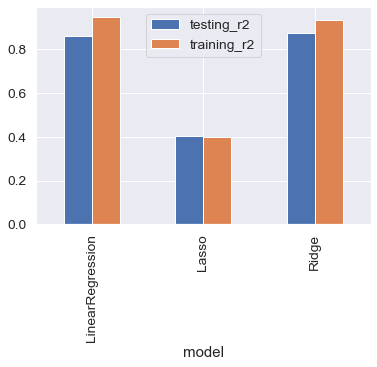

In [145]:
scores_df.plot(x="model", y=["testing_r2", "training_r2"], kind="bar")

By using all 258 features and using arbitrary alpha value in Lasso and Ridge we get a r2 score of 40 - 94 % on training set and around 41 - 87% on testing set.<br>
Clearly there is some amount of overfitting that can be observed.

Also the models were built using arbitrary alpha values for Lasso and Ridge

We will try to find the optimal value of alpha using Cross Validation schemes which will also help us produce a more generalizable model.


Fitting 5 folds for each of 28 candidates, totalling 140 fits
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    2.2s finished


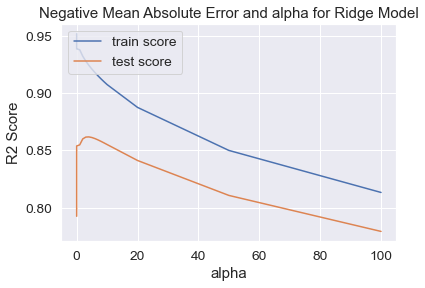

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.008200,0.001165,0.003599,0.000801,0,{'alpha': 0.0001},0.756541,0.740399,0.857132,0.859145,0.749510,0.792545,0.053804,25,0.951599,0.953097,0.951478,0.950999,0.951763,0.951787,0.000703
1,0.006999,0.000893,0.002999,0.000001,0,{'alpha': 0.001},0.759084,0.740776,0.857760,0.860169,0.750330,0.793624,0.053669,24,0.951597,0.953097,0.951476,0.950996,0.951762,0.951786,0.000704
2,0.008000,0.000894,0.003800,0.000748,0,{'alpha': 0.01},0.779586,0.744350,0.862730,0.867505,0.757328,0.802300,0.052536,23,0.951443,0.953066,0.951286,0.950787,0.951728,0.951662,0.000766
3,0.008601,0.001021,0.004199,0.000399,0,{'alpha': 0.05},0.820835,0.756636,0.872420,0.877565,0.775952,0.820681,0.049021,21,0.949865,0.952678,0.949474,0.949051,0.951247,0.950463,0.001331
4,0.007602,0.001855,0.002798,0.000400,0,{'alpha': 0.1},0.838681,0.766756,0.876430,0.879376,0.788620,0.829972,0.045566,20,0.947947,0.952011,0.947336,0.947218,0.950393,0.948981,0.001900
5,0.006000,0.000632,0.002599,0.000490,0,{'alpha': 0.2},0.851971,0.779151,0.879120,0.878846,0.802839,0.838385,0.040628,19,0.945104,0.950638,0.944200,0.944659,0.948649,0.946650,0.002540
6,0.006201,0.000401,0.002598,0.000489,0,{'alpha': 0.3},0.857691,0.786903,0.880178,0.877884,0.811561,0.842843,0.037283,17,0.943073,0.949402,0.941973,0.942847,0.947098,0.944878,0.002871
7,0.007000,0.000632,0.002800,0.000400,0,{'alpha': 0.4},0.861034,0.792448,0.880801,0.877129,0.817916,0.845866,0.034821,16,0.941498,0.948313,0.940245,0.941424,0.945742,0.943444,0.003069
8,0.007601,0.000801,0.003599,0.000491,0,{'alpha': 0.5},0.863297,0.796716,0.881237,0.876578,0.822933,0.848152,0.032905,15,0.940208,0.947343,0.938824,0.940239,0.944544,0.942231,0.003198
9,0.007698,0.000749,0.002799,0.000401,0,{'alpha': 0.6},0.864958,0.800154,0.881562,0.876178,0.827068,0.849984,0.031355,14,0.939111,0.946466,0.937609,0.939212,0.943467,0.941173,0.003289


In [162]:
# list of alphas to tune
params = {'alpha': [0.0001, 0.001, 0.01, 0.05, 0.1, 
 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1.0, 2.0, 3.0, 
 4.0, 5.0, 6.0, 7.0, 8.0, 9.0, 10.0, 20, 50, 100, 500, 1000 ]}

ridge = Ridge()
lasso = Lasso()

def tune_paramters_for_model(model,params):
    # cross validation
    folds = 5
    model_cv = GridSearchCV(estimator = model, 
                            param_grid = params, 
                            scoring= 'r2', 
                            cv = folds, 
                            return_train_score=True,
                            verbose = 1)            
    model_cv.fit(X_train, y_train) 

    cv_results = pd.DataFrame(model_cv.cv_results_)
    cv_results = cv_results[cv_results['param_alpha']<=200]

    # plotting mean test and train scoes with alpha 
    cv_results['param_alpha'] = cv_results['param_alpha'].astype('int32')

    # plotting
    plt.plot(cv_results['param_alpha'], cv_results['mean_train_score'])
    plt.plot(cv_results['param_alpha'], cv_results['mean_test_score'])
    plt.xlabel('alpha')
    plt.ylabel('R2 Score')
    plt.title(f"Negative Mean Absolute Error and alpha for {str(model.__class__).split('.')[-1][:-2]} Model")
    plt.legend(['train score', 'test score'], loc='upper left')
    # plt.xscale('log')

    plt.show()

    return cv_results

ridge_cv_results = tune_paramters_for_model(ridge,params)
ridge_cv_results

Fitting 5 folds for each of 28 candidates, totalling 140 fits
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 140 out of 140 | elapsed:    2.6s finished


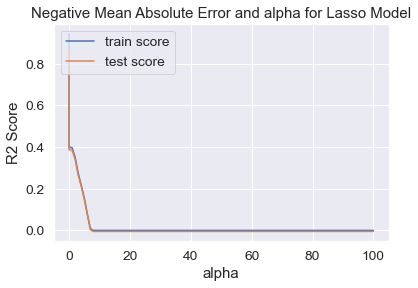

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,mean_test_score,std_test_score,rank_test_score,split0_train_score,split1_train_score,split2_train_score,split3_train_score,split4_train_score,mean_train_score,std_train_score
0,0.067992,0.023546,0.003205,7.542644e-04,0,{'alpha': 0.0001},0.853222,0.796633,0.873826,0.884957,0.776005,0.836929,0.043056,2,0.942914,0.948329,0.940787,0.940196,0.947008,0.943847,0.003276
1,0.013000,0.001898,0.003200,7.485838e-04,0,{'alpha': 0.001},0.869426,0.840326,0.872688,0.890027,0.849433,0.864380,0.017631,1,0.902852,0.911567,0.896663,0.900584,0.907200,0.903773,0.005178
2,0.009600,0.000490,0.004200,3.990655e-04,0,{'alpha': 0.01},0.768965,0.726597,0.750873,0.690584,0.740513,0.735506,0.026374,3,0.755482,0.765807,0.743707,0.758264,0.761353,0.756922,0.007444
3,0.009400,0.001357,0.004001,6.321837e-04,0,{'alpha': 0.05},0.545787,0.485008,0.509795,0.406288,0.472630,0.483902,0.046157,4,0.483990,0.509410,0.474715,0.517000,0.510020,0.499027,0.016546
4,0.010203,0.000977,0.004197,3.952525e-04,0,{'alpha': 0.1},0.457963,0.404556,0.434022,0.312150,0.377247,0.397188,0.050465,6,0.397695,0.415578,0.400430,0.434159,0.419685,0.413509,0.013342
5,0.009000,0.000632,0.003400,4.906221e-04,0,{'alpha': 0.2},0.455524,0.407445,0.431144,0.316868,0.377344,0.397665,0.047969,5,0.397250,0.412692,0.399795,0.430807,0.418564,0.411822,0.012358
6,0.008206,0.000990,0.003195,7.425005e-04,0,{'alpha': 0.3},0.452845,0.408463,0.428278,0.318017,0.378304,0.397181,0.046510,7,0.396509,0.411932,0.398960,0.430059,0.417833,0.411058,0.012375
7,0.010203,0.000981,0.003999,1.095280e-03,0,{'alpha': 0.4},0.449916,0.409129,0.425148,0.318798,0.378912,0.396381,0.045123,8,0.395471,0.410868,0.397791,0.429012,0.416808,0.409990,0.012399
8,0.011400,0.001355,0.004601,4.931056e-04,0,{'alpha': 0.5},0.446743,0.409441,0.421756,0.319235,0.379164,0.395268,0.043801,9,0.394137,0.409499,0.396289,0.427665,0.415491,0.408616,0.012430
9,0.010399,0.001357,0.004000,6.337669e-04,0,{'alpha': 0.6},0.443325,0.409398,0.418104,0.319319,0.379062,0.393842,0.042547,10,0.392506,0.407827,0.394452,0.426019,0.413882,0.406937,0.012468


In [163]:
lasso_cv_results = tune_paramters_for_model(lasso,params)
lasso_cv_results

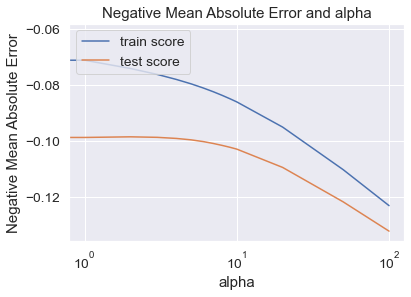

Lets take alpha as 8.

In [165]:
ridge_model = Ridge(alpha=4)
lasso_model = Lasso(alpha = 0.01)

fit_evalaute_models([ridge_model,lasso_model],X_train, X_test, y_train, y_test)


{'model': 'Ridge', 'training_r2': 0.9214284510264217, 'testing_r2': 0.8680388061730799}
{'model': 'Lasso', 'training_r2': 0.7557754689941185, 'testing_r2': 0.7434336133910635}


,model,testing_r2,training_r2
0,Ridge,0.868039,0.921428
1,Lasso,0.743434,0.755775


## Feature Selection

We will use RFECV along with Linear Model to find the optimal number of features 

In [149]:
?RFECV

Init signature:
RFECV(
    estimator,
    *,
    step=1,
    min_features_to_select=1,
    cv=None,
    scoring=None,
    verbose=0,
    n_jobs=None,
)
Docstring:     
Feature ranking with recursive feature elimination and cross-validated
selection of the best number of features.

See glossary entry for :term:`cross-validation estimator`.

Read more in the :ref:`User Guide <rfe>`.

Parameters
----------
estimator : object
    A supervised learning estimator with a ``fit`` method that provides
    information about feature importance either through a ``coef_``
    attribute or through a ``feature_importances_`` attribute.

step : int or float, optional (default=1)
    If greater than or equal to 1, then ``step`` corresponds to the
    (integer) number of features to remove at each iteration.
    If within (0.0, 1.0), then ``step`` corresponds to the percentage
    (rounded down) of features to remove at each iteration.
    Note that the last iteration may remove fewer than ``step`` feat

In [94]:
from sklearn.linear_model import Lasso

In [166]:
lm = LinearRegression()
lasso_model = Lasso(alpha=0.5)
ridge = Ridge(alpha=4)
# set up cross validation scheme
# folds = KFold(n_splits = 10, shuffle = True, random_state = 4)

rfecv = RFECV(estimator=ridge, step=1, cv=5, scoring='neg_mean_absolute_error',n_jobs=-1)
rfecv.fit(X_train, y_train)

RFECV(cv=5, estimator=Ridge(alpha=4), n_jobs=-1,
      scoring='neg_mean_absolute_error')

In [167]:
print(f'Optimal number of features: {rfecv.n_features_}')

Optimal number of features: 200


https://medium.com/@anushaswamy.n/house-prices-advanced-regression-techniques-a1e2a595af6b

https://www.kaggle.com/shaliniyaramada/house-prices-eda-rfe-ridge-regression

https://www.kaggle.com/aniketnayakawadi/house-price-prediction-eda-rmse-0-09